In [ ]:
import pandas as pd

# Create dummy customer information for the same trip
data = {
    "Customer_ID": [1, 2],
    "Customer_Name": ["Alice Johnson", "Bob Smith"],
    "Age": [12, 70],
    "Gender": ["Female", "Male"],
    "Extras":["Smooth Adventurous Picnic", "Should Animals"],
    "Destination": ["Paris, France"] * 2,  # Same destination for all
    "Travel_Dates": ["2024-01-15 to 2024-01-20"] * 2,  # Same travel dates for all
    "Total_Days" : [2 for i in range(2)],
    "Themes": ["Romantic"] * 2,  # Same theme for all
    "Special_Activities": [
        "Eiffel Tower dinner, Seine river cruise",  # Shared itinerary
        "Eiffel Tower dinner, Seine river cruise",
    ]
}
# Create a DataFrame
customer_df = pd.DataFrame(data)

# Display the DataFrame
print(customer_df)

   Customer_ID  Customer_Name  Age  Gender                     Extras  \
0            1  Alice Johnson   12  Female  Smooth Adventurous Picnic   
1            2      Bob Smith   70    Male             Should Animals   

     Destination              Travel_Dates  Total_Days    Themes  \
0  Paris, France  2024-01-15 to 2024-01-20           2  Romantic   
1  Paris, France  2024-01-15 to 2024-01-20           2  Romantic   

                        Special_Activities  
0  Eiffel Tower dinner, Seine river cruise  
1  Eiffel Tower dinner, Seine river cruise  


In [ ]:
itinerary = {
    "Day_1" : "Evening cruise on the Seine",
    "Day_2" : "Sunset at Montmartre",
}

## Code creating personalised prompts

In [ ]:
pip install -q google-generativeai

In [ ]:
import os
import google.generativeai as genai
import pandas as pd
from google.colab import userdata

import json

GOOGLE_API_KEY=""

def configure_genai(GOOGLE_API_KEY, model_name="gemini-1.5-flash", generation_config=None):
    """
    Configures the Generative AI model with API key and settings.

    Args:
        api_key_var_name (str): Environment variable name for the API key.
        model_name (str): Model name for the Generative AI.
        generation_config (dict): Configuration for generation.

    Returns:
        genai.GenerativeModel: Configured Generative AI model.
    """
    api_key = GOOGLE_API_KEY

    if not api_key:
        raise ValueError(f"API key not found in environment variable: {api_key_var_name}")

    genai.configure(api_key=api_key)

    if not generation_config:
        generation_config = {
            "temperature": 0.4, # Controls the randomness of the generated output. Lower values (e.g., 0.1) make the output more deterministic, while higher values (e.g., 1.0) make it more random.
            "top_p": 0.95,# Determines the cumulative probability of the smallest set of top tokens to consider. This is known as "nucleus sampling". A value of 0.95 means the model will consider the smallest set of tokens that cumulatively sum to 95% probability.
            "top_k": 36, # Limits the number of highest probability tokens to sample from. If set to 36, the model will only consider the top 36 tokens at each generation step.
            "max_output_tokens": 8192,# Sets the maximum number of tokens that can be generated. This defines how long the model's output can be, in terms of tokens (words, characters, etc.).
            "response_mime_type": "text/plain", # Specifies the MIME type of the generated response. "text/plain" indicates plain text, which is typical for text generation.
        }

    return genai.GenerativeModel(model_name=model_name, generation_config=generation_config)

def generate_prompt(customer, itinerary):
    """
    Generate a prompt for a specific customer and itinerary.

    Args:
        customer (dict): Customer details as a dictionary.
        itinerary (dict): The trip itinerary.

    Returns:
        str: Generated prompt for the customer.
    """
    return f"""

You are tasked with generating personalized prompts to be passed to an image generation model. These prompts must vividly and realistically describe engaging scenes for each day of a customer's trip, crafted uniquely to their preferences, age, gender, and trip details.

### Requirements:
1. **Deep Personalization**:
   - Tailor the prompts to reflect the customer's age, gender, and preferences. Incorporate their extra requirements seamlessly into the visual scene descriptions.
   - Avoid making people the main highlights of the scene; instead, focus on environmental and contextual elements that align with the customer's details. Do not have a person as a highlight element in the image prompt.
   - Reflect the trip's theme (e.g., romantic, adventurous) by enhancing the atmosphere, colors, and mood of the scene.
   - Include unique, personalized elements in each scene to ensure the itinerary feels custom-made for the customer.

2. **Enhanced Visual Descriptions**:
   - Use detailed and vivid language to bring the scene to life. Include elements like time of day, weather, ambiance, and cultural aspects specific to the destination.
   - Incorporate iconic landmarks and unique features of the destination to create a captivating and realistic image for the customer.
   - Generate prompts that make the images feel real.

3. **Base Itinerary Integration**:
   - Utilize the provided itinerary to guide the main activities for each day of the trip. Expand on these activities with detailed, location-specific descriptions to make each scene visually compelling.
   - Ensure prompts for each day naturally align with the flow of the trip and reflect the local culture and environment.

4. **Formatting and Output**:
   - Generate prompts for all days of the trip for each customer.
   - Structure the output as a JSON object containing the following keys:
     - `CustomerName`: The full name of the customer.
     - `CustomerID`: The unique identifier for the customer.
     - `Prompts`: A dictionary containing prompts for each day of the trip, with keys `Day_1`, `Day_2`, etc.
   - Ensure all keys start with a capital letter.
   - Make sure the length of the prompts does not exceed 220 characters.

### Inputs:
- **Customer Information**:
  - Name: {customer['Customer_Name']}
  - Age: {customer['Age']}
  - Gender: {customer['Gender']}
  - Extra requirements: {customer['Extras']}
  - Destination: {customer['Destination']}
  - Theme: {customer['Themes']}
  - Special Activities: {customer['Special_Activities']}
- **Base Itinerary**:
  {itinerary}

### Schema:

- CustomerName
- CustomerID
- Prompts
  - Day_1
  - Day_2

### Expectations:
- Ensure that each prompt is highly specific and personalized to the customer.
- Use evocative language to ensure the generated scenes are visually stunning and align with the customer's preferences and trip details.
- Provide the output in the JSON format strictly, adhering to the schema without additional commentary or unnecessary information.


"""

def store_llm_response(response_data, file_path='final_response.json'):
    """
    Stores LLM response data into a JSON file.

    Args:
        response_data (str): The raw response string from the model.
        file_path (str): Path to the JSON file where the response is stored.

    Returns:
        None
    """
    try:
        if response_data.startswith("```json"):
            response_data = response_data[7:].strip()
        if response_data.endswith("```"):
            response_data = response_data[:-3].strip()

        if not response_data.strip():
            print("The response is empty.")
            return

        try:
            parsed_data = json.loads(response_data)
        except json.JSONDecodeError:
            print("Invalid JSON response. Raw response:")
            print(response_data)
            return

        if os.path.exists(file_path):
            with open(file_path, 'r') as json_file:
                existing_data = json.load(json_file)
        else:
            existing_data = {}

        if 'responses' not in existing_data:
            existing_data['responses'] = []

        existing_data['responses'].append(parsed_data)

        with open(file_path, 'w') as json_file:
            json.dump(existing_data, json_file, indent=4)

        print(f"Response successfully saved to {file_path}")

    except Exception as e:
        print(f"Error while saving response: {e}")



In [ ]:
def personalized_prompts(customer_df, itinerary):
    # Step 1: Configure the Generative AI model
    model = configure_genai(GOOGLE_API_KEY) # Corrected line

    # Step 2: Iterate over each customer in the DataFrame
    for _, customer in customer_df.iterrows():
        # Convert customer row to dictionary
        customer_data = customer.to_dict()

        # Generate the prompt for the current customer
        prompt = generate_prompt(customer_data, itinerary)

        # Step 3: Generate the content using the model
        response = model.generate_content(prompt)
        response_text = response.text

        # Step 4: Store the response
        store_llm_response(response_text)

        print(f"Response for {customer_data['Customer_Name']} saved.")

# ... rest of your code ...

if __name__ == "__main__":
    personalized_prompts(customer_df, itinerary)

Response successfully saved to final_response.json
Response for Alice Johnson saved.
Response successfully saved to final_response.json
Response for Bob Smith saved.


## Storing Prompts in Array

## Reading Data From Different Sources

<details>
    <summary>Click here to view more</summary>


### **Files**

In many cases, the data is stored in the local system. To read the data from the local system, specify the correct path and filename.

### **CSV Format**
Comma-separated values, also known as CSV, is a specific way to store data in a table structure format. The data used in this project is stored in a CSV file. Download the data for the project.


Use following code to read data from csv file using pandas.
```
import pandas as pd
csv_file_path= "D:/ProjectPro/Telecom Machine Learning Project to Predict Customer Churn/data/Telecom_data.csv"
df = pd.read_csv(csv_file_path)
```
With appropriate csv_file_path, pd.read_csv() function will read the data and store it in df variable.

If you get *FileNotFoundError or No such file or directory*, try checking the path provided in the function. It's possible that python is not able to find the file or directory at a given location.


### **Colab - CSV Format**

```
# mount the google drive
from google.colab import drive
drive.mount('/content/drive')
csv_file_path= '/content/drive/MyDrive/project_pro/Telecom Machine Learning Project to Predict Customer Churn/Telecom_data.csv'
df = pd.read_csv(csv_file_path)
```

### **AWS S3 - CSV**
Use the S3 public link to read the CSV file directly into a pandas DataFrame
```
s3_link = 'https://s3.amazonaws.com/projex.dezyre.com/telecom-machine-learning-project-for-customer-churn/materials/Telecom_data.csv'
df = pd.read_csv(s3_link)
```

### **Database**
Most organizations store their data in databases such as MS SQL. Microsoft SQL Server (MS SQL) is a relational database management system developed by Microsoft. A BAK file in Microsoft SQL Server is a backup file that contains a copy of a SQL Server database at a specific point in time. It is essentially a binary representation of the database and includes all its data, tables, schema, indexes, stored procedures, and other objects.

#### **Installing MS SQL Management Studio**
To install Microsoft SQL Server Management Studio, you can follow these steps:

* Go to the Microsoft SQL Server Downloads page (https://www.microsoft.com/en-us/sql-server/sql-server-downloads) and click on the "Download now" button for the version of SQL Server Management Studio that you want to install.
* Follow the instructions on the screen to download the installation file to your computer.
* Once the download is complete, locate the installation file and double-click on it to start the installation process.

#### **Query to read the data into Pandas**

```

query = '''select * from Processed_month_1_data
           UNION ALL
            select * from Processed_month_2_data
            UNION ALL
            select * from Processed_month_3_data
            UNION ALL
            select * from Processed_month_4_data
            UNION ALL
            select * from Processed_month_5_data
            UNION ALL
            select * from Processed_month_6_data
            UNION ALL
            select * from Processed_month_7_data
            UNION ALL
            select * from Processed_month_8_data
            UNION ALL
            select * from Processed_month_9_data
            UNION ALL
            select * from Processed_month_10_data
            UNION ALL
            select * from Processed_month_11_data
            UNION ALL
            select * from Processed_month_12_data
            UNION ALL
            select * from Processed_month_13_data
            UNION ALL
            select * from Processed_month_14_data'''
processed_data = pd.read_sql(query,connection)
processed_data.head()

```


In [ ]:
import json

def load_json(file_path):
    """
    Load JSON data from a file.

    Args:
        file_path (str): Path to the JSON file.

    Returns:
        dict: Parsed JSON data.
    """
    try:
        with open(file_path, 'r') as file:
            return json.load(file)
    except Exception as e:
        print(f"Error loading JSON file: {e}")
        return None

def extract_prompts(json_data, total_days):
    """
    Extract prompts for each day for all customers in the JSON data.

    Args:
        json_data (dict): The JSON data containing responses.
        total_days (int): Number of days in the itinerary.

    Returns:
        list: List of prompts for all days for all customers.
    """
    prompts_array = []

    try:
        for response in json_data.get('responses', []):
            for day in range(total_days):
                day_key = f"Day_{day + 1}"
                if day_key in response.get('Prompts', {}):
                    prompts_array.append(response['Prompts'][day_key])
                else:
                    print(f"Day key '{day_key}' not found in response.")
    except Exception as e:
        print(f"Error extracting prompts: {e}")

    return prompts_array

def storing_prompts_in_array(file_path = 'final_response.json',total_days = customer_df["Total_Days"][0]):
    """
    Main function to load JSON data and extract prompts.

    Returns:
        None
    """

    # Load JSON data
    json_data = load_json(file_path)

    if not json_data:
        print("Failed to load JSON data.")
        return

    # Extract prompts
    prompts_array = extract_prompts(json_data, total_days)

    # Print the extracted prompts
    print("Extracted Prompts:", prompts_array)
    return prompts_array

if __name__ == "__main__":
    prompt_array = storing_prompts_in_array(file_path = 'final_response.json')


Extracted Prompts: ['Romantic Seine River cruise at sunset, Parisian lights shimmering on the water, smooth gentle waves, a picnic basket with delicious treats.', 'Montmartre at sunset, vibrant colors painting the sky, charming cobblestone streets, a smooth, adventurous picnic blanket overlooking the city.', 'Romantic Parisian evening: Seine River cruise at sunset, golden light reflecting on the water, Eiffel Tower shimmering in the distance, a lone swan gliding peacefully.', 'Montmartre at sunset: Charming cobblestone streets, vibrant colors of the setting sun casting long shadows, a friendly stray cat near a flower stall, Sacré-Cœur Basilica glowing warmly.', 'Romantic Seine River cruise at sunset, Parisian lights reflecting on the water, smooth gentle waves, a picnic basket with macarons', 'Montmartre at sunset, vibrant colors painting the sky, charming Parisian streets, a smooth, adventurous picnic blanket on a hill overlooking the city', 'Romantic Seine River cruise at sunset, Par

In [ ]:
print(prompt_array)

['Romantic Seine River cruise at sunset, Parisian lights shimmering on the water, smooth gentle waves, a picnic basket with delicious treats.', 'Montmartre at sunset, vibrant colors painting the sky, charming cobblestone streets, a smooth, adventurous picnic blanket overlooking the city.', 'Romantic Parisian evening: Seine River cruise at sunset, golden light reflecting on the water, Eiffel Tower shimmering in the distance, a lone swan gliding peacefully.', 'Montmartre at sunset: Charming cobblestone streets, vibrant colors of the setting sun casting long shadows, a friendly stray cat near a flower stall, Sacré-Cœur Basilica glowing warmly.', 'Romantic Seine River cruise at sunset, Parisian lights reflecting on the water, smooth gentle waves, a picnic basket with macarons', 'Montmartre at sunset, vibrant colors painting the sky, charming Parisian streets, a smooth, adventurous picnic blanket on a hill overlooking the city', 'Romantic Seine River cruise at sunset, Parisian bridges, gent

## Generating images and storing them in respective folders.

## Stable Diffusion xl base 1.0

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

text_encoder_2/model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/5.14G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.fp16.saf(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved as 'images/batch_1/image_1.png'


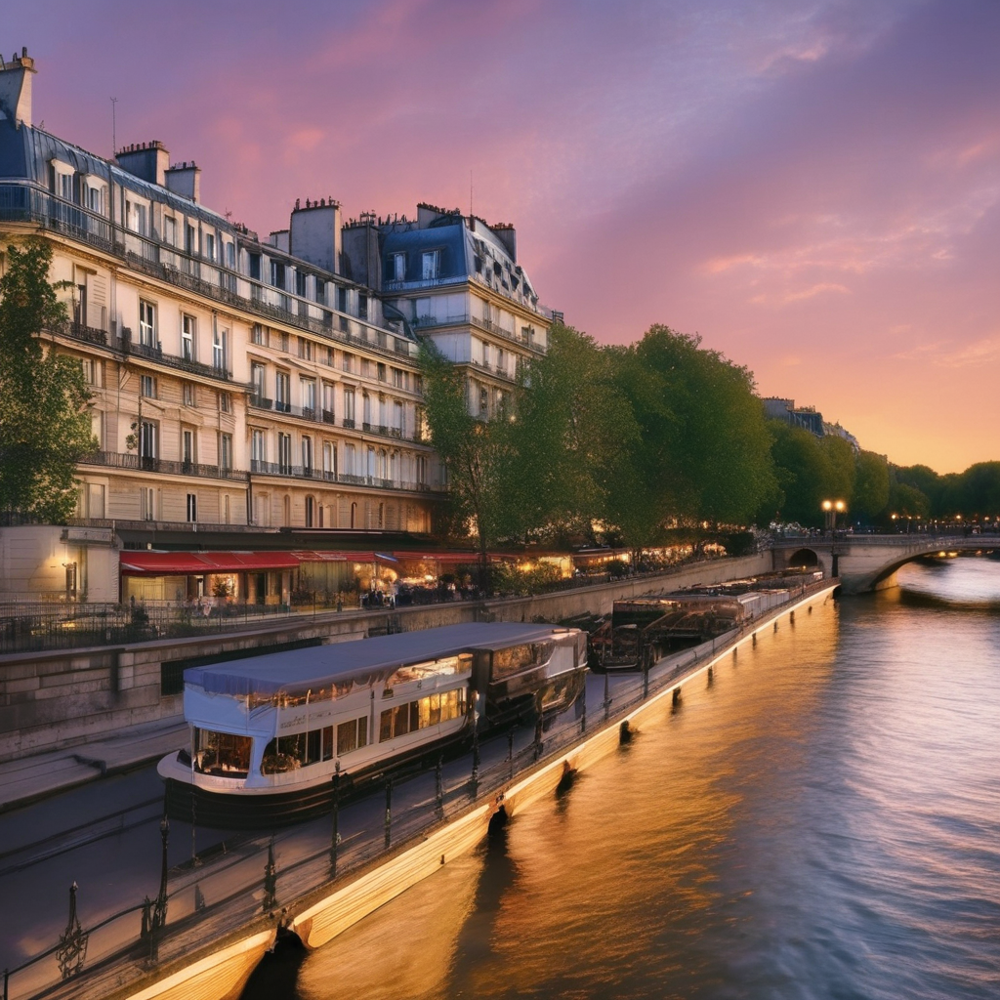

Displayed: images/batch_1/image_1.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved as 'images/batch_1/image_2.png'


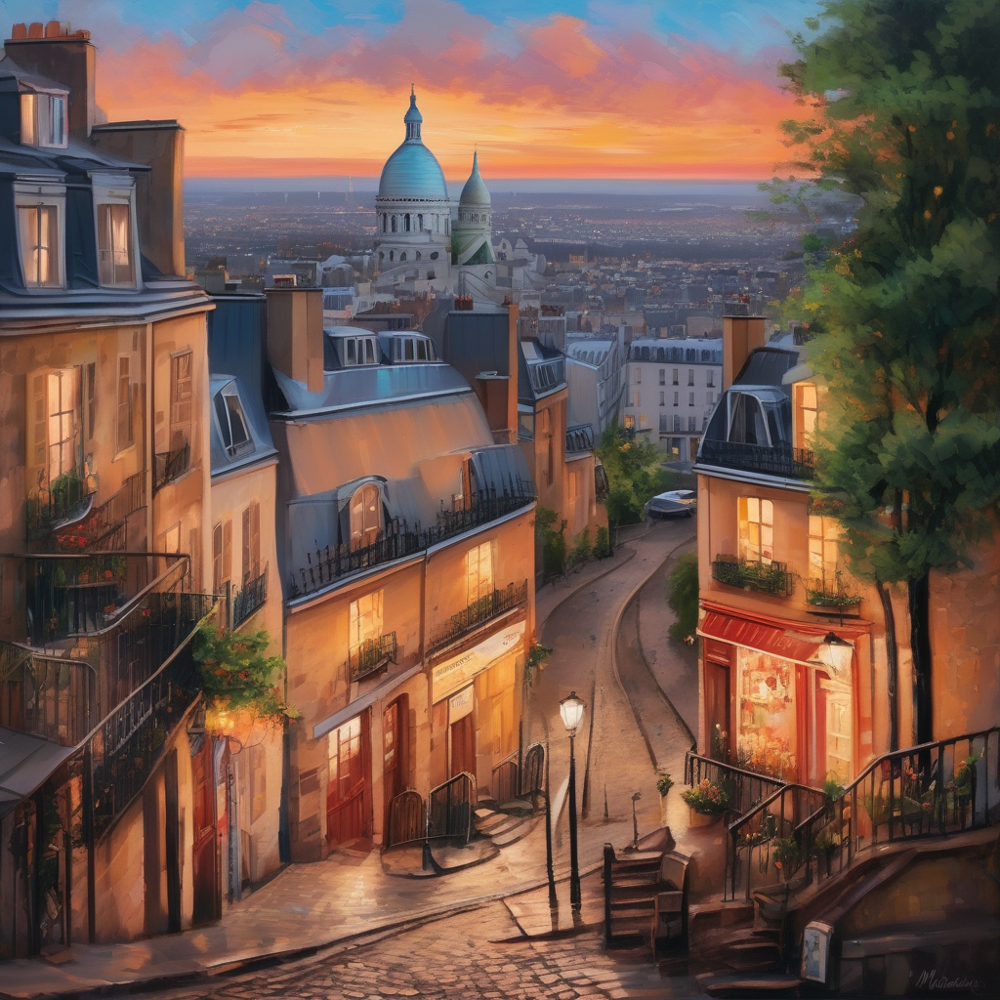

Displayed: images/batch_1/image_2.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved as 'images/batch_2/image_3.png'


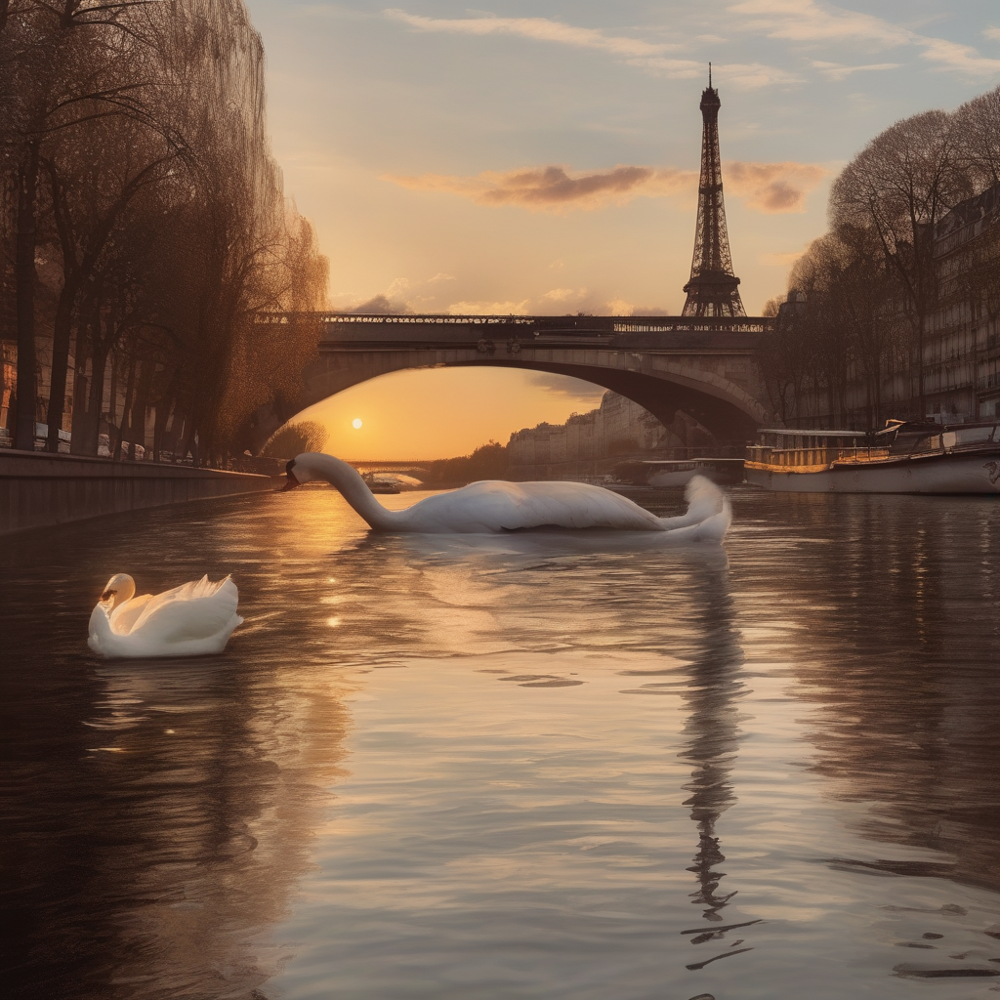

Displayed: images/batch_2/image_3.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved as 'images/batch_2/image_4.png'


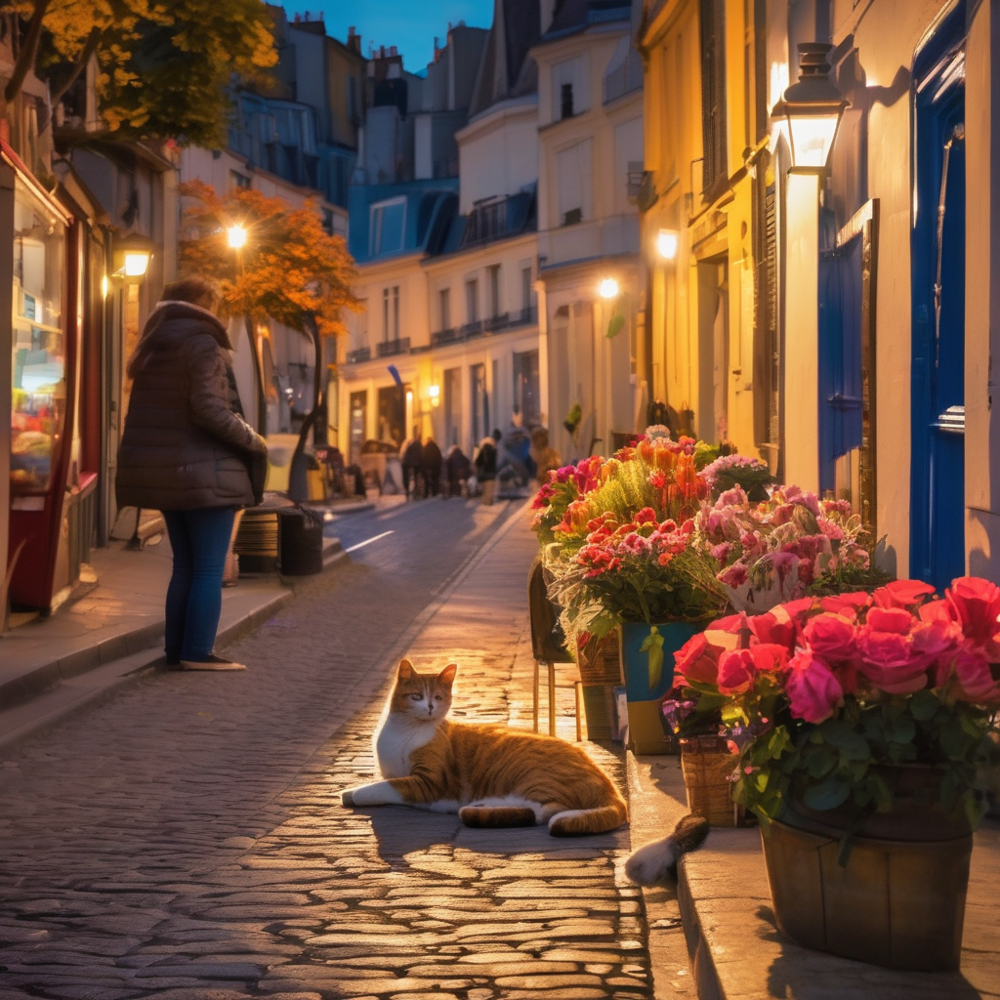

Displayed: images/batch_2/image_4.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved as 'images/batch_3/image_5.png'


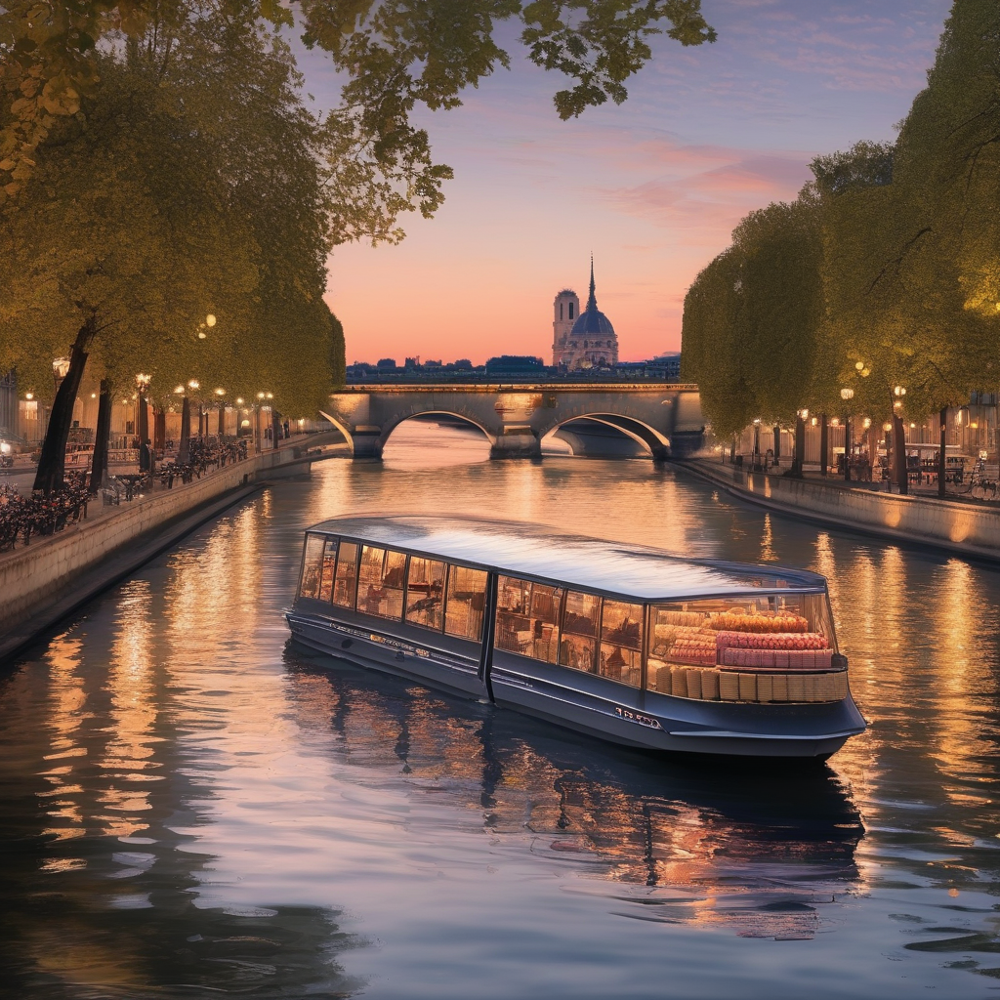

Displayed: images/batch_3/image_5.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved as 'images/batch_3/image_6.png'


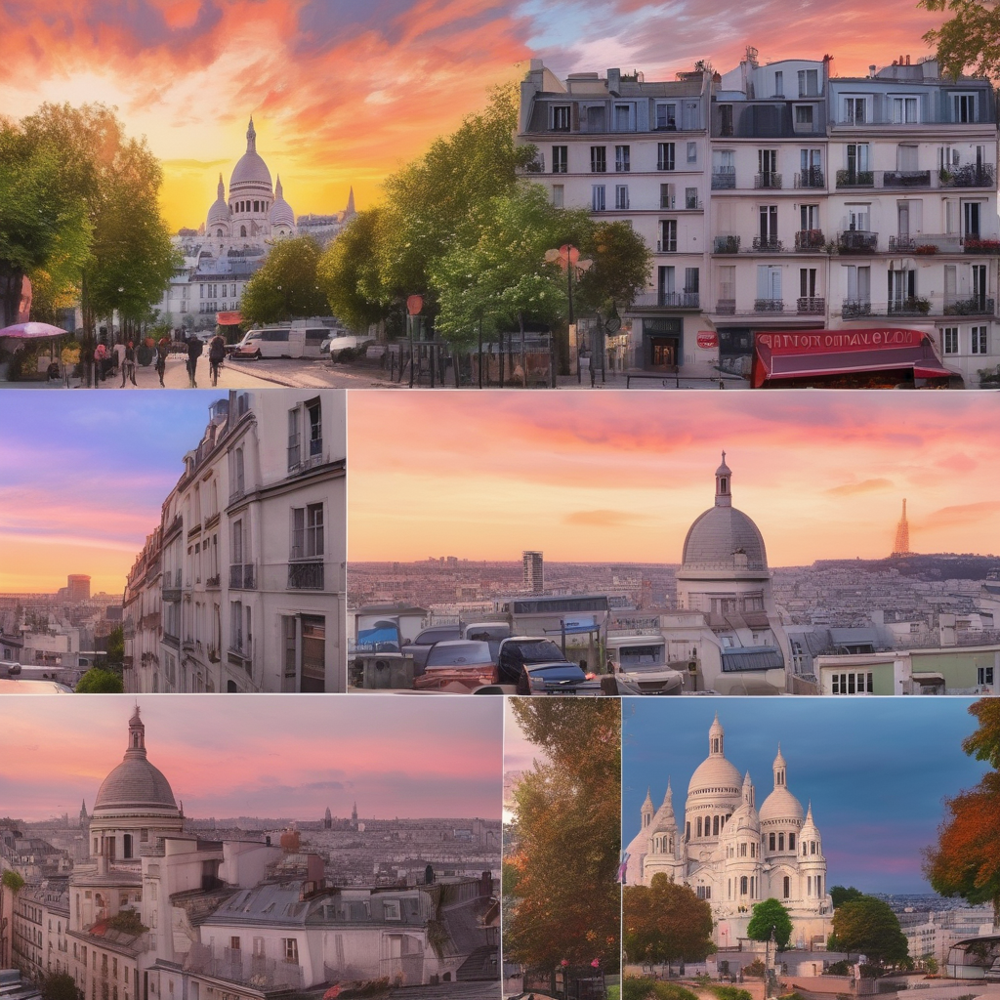

Displayed: images/batch_3/image_6.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved as 'images/batch_4/image_7.png'


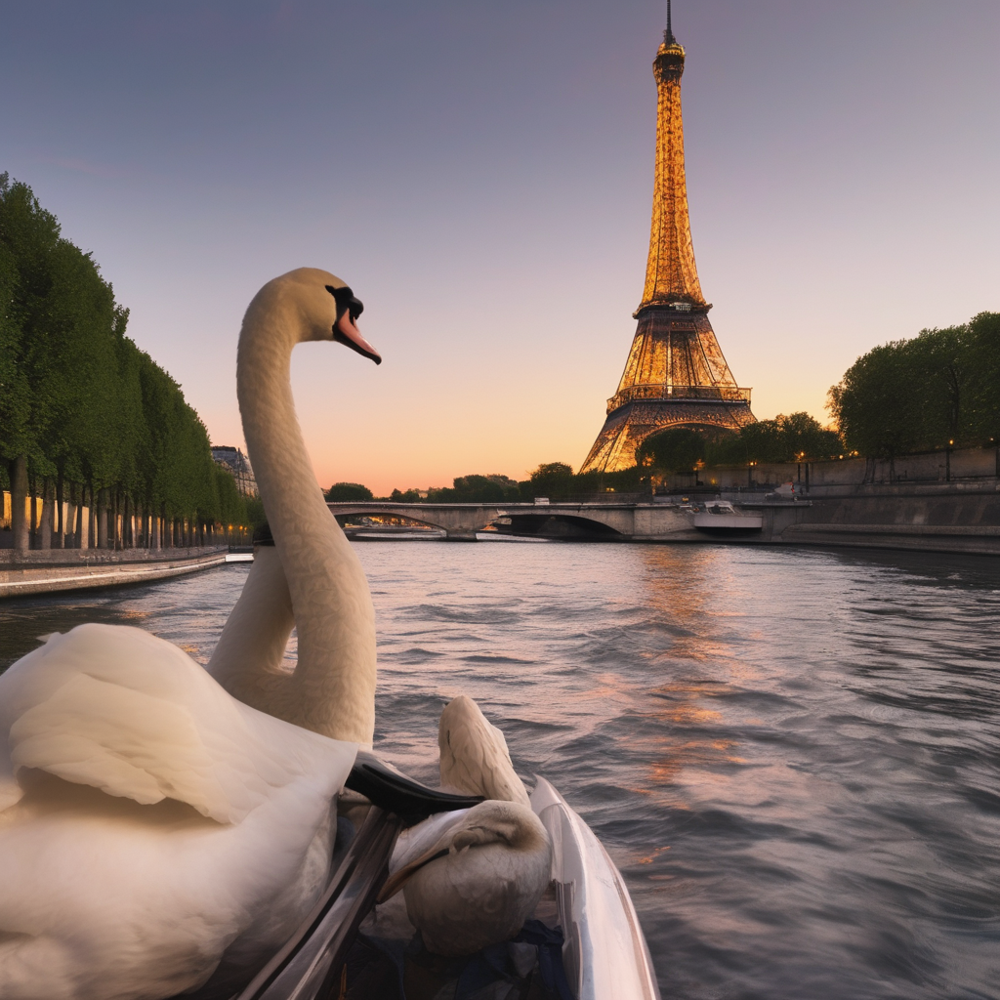

Displayed: images/batch_4/image_7.png


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved as 'images/batch_4/image_8.png'


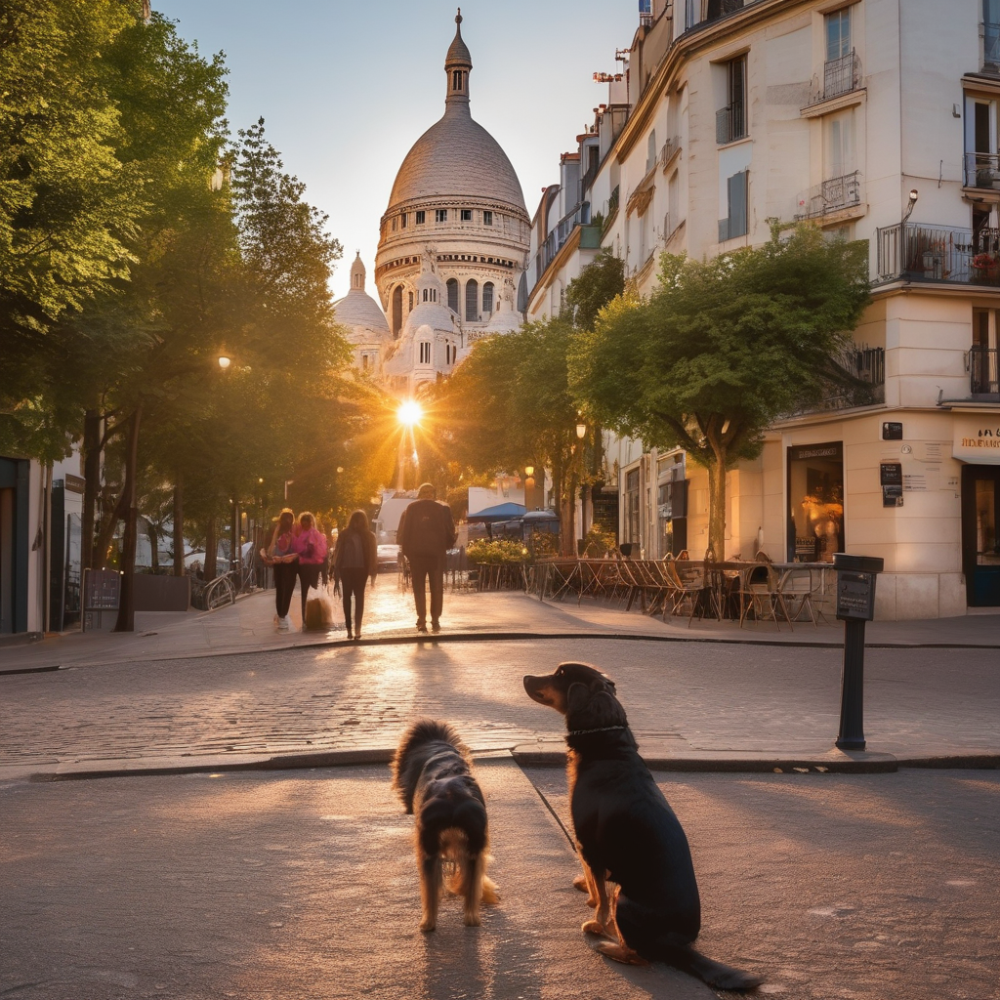

Displayed: images/batch_4/image_8.png
All images saved in 'images'.


In [ ]:
from diffusers import DiffusionPipeline
import torch
import os
from PIL import Image
from IPython.display import display  # For inline display in Colab

def generate_image_from_prompt(prompt, model_name, output_file, device="cuda"):
    """
    Generate an image based on a given prompt using a diffusion model and save the result.

    Args:
        prompt (str): The text prompt to generate the image.
        model_name (str): The name of the pre-trained model to use.
        output_file (str): The filename to save the generated image.
        device (str): The device to run the model on (e.g., "cuda" for GPU or "cpu").

    Returns:
        str: The path to the saved image.
    """
    # Load the model pipeline
    pipe = DiffusionPipeline.from_pretrained(
        model_name,
        torch_dtype=torch.float16,
        use_safetensors=True,
        variant="fp16"
    )
    pipe.to(device)

    # Generate the image
    image = pipe(prompt=prompt).images[0]

    # Save the image
    image.save(output_file)
    print(f"Image saved as '{output_file}'")

    return output_file

def save_images_to_batches(prompts, model_name, output_dir="images", device="cuda"):
    """
    Generate images from prompts and organize them into batch folders.

    Args:
        prompts (list): List of text prompts for image generation.
        model_name (str): The name of the pre-trained model to use.
        output_dir (str): Base directory to save the images.
        device (str): The device to run the model on (e.g., "cuda" for GPU or "cpu").

    Returns:
        None
    """
    os.makedirs(output_dir, exist_ok=True)  # Create the base directory if it doesn't exist

    batch_number = 1  # Initialize batch number
    batch_folder = os.path.join(output_dir, f"batch_{batch_number}")
    os.makedirs(batch_folder, exist_ok=True)  # Create the first batch folder

    for i, prompt in enumerate(prompts):
        # Save images in current batch folder
        output_file = os.path.join(batch_folder, f"image_{i + 1}.png")
        image_path = generate_image_from_prompt(prompt, model_name, output_file, device)

        # Display the image inline in Colab
        image = Image.open(image_path)
        display(image)  # Inline display
        print(f"Displayed: {image_path}")

        # Move to the next batch if a new user is processed
        if (i + 1) % customer_df['Total_Days'][0] == 0 and i + 1 < len(prompts):
            batch_number += 1
            batch_folder = os.path.join(output_dir, f"batch_{batch_number}")
            os.makedirs(batch_folder, exist_ok=True)  # Create the next batch folder

    print(f"All images saved in '{output_dir}'.")

# Example usage
if __name__ == "__main__":
    model_name = "stabilityai/stable-diffusion-xl-base-1.0"
    save_images_to_batches(prompt_array, model_name, output_dir="images")


## Image to Image

In [ ]:
import PIL.Image
import torch
from diffusers import StableDiffusionInstructPix2PixPipeline, EulerAncestralDiscreteScheduler

def load_pipeline(model_id="timbrooks/instruct-pix2pix", device="cuda"):
    """
    Loads the pre-trained StableDiffusionInstructPix2PixPipeline and sets up the scheduler.

    Args:
        model_id (str): The model ID for the pre-trained pipeline.
        device (str): The device to run the model on (e.g., "cuda" for GPU or "cpu").

    Returns:
        pipe: The pipeline for the model.
    """
    pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(
        model_id,
        torch_dtype=torch.float16,
        safety_checker=None
    )
    pipe.to(device)
    pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)

    return pipe

def load_image(image_path):
    """
    Loads an image from the given path.

    Args:
        image_path (str): Path to the image.

    Returns:
        PIL.Image.Image: Loaded image in RGB format.
    """
    image = PIL.Image.open(image_path).convert("RGB")
    return image

def generate_image(pipe, prompt, image, num_inference_steps=10, image_guidance_scale=1):
    """
    Generates an image based on a given prompt and input image using the model pipeline.

    Args:
        pipe: The loaded pipeline.
        prompt (str): The prompt to guide the image generation.
        image: The input image to apply transformations to.
        num_inference_steps (int): The number of inference steps for the image generation.
        image_guidance_scale (float): The scale to guide the image generation.

    Returns:
        PIL.Image.Image: The generated image.
    """
    images = pipe(prompt, image=image, num_inference_steps=num_inference_steps, image_guidance_scale=image_guidance_scale).images
    return images[0]

def save_image(image, output_path):
    """
    Saves the generated image to the specified path.

    Args:
        image: The image to be saved.
        output_path (str): Path where the image will be saved.
    """
    image.save(output_path)
    print(f"Image saved as '{output_path}'")

def change_image(image_path = "/content/images/batch_3/image_5.png",
    output_path = "/content/output_image.png",
    prompt = "Add sunset to the background."):
    """
    Main function to load the pipeline, process the image, and generate the output image.
    """
    # Load model pipeline
    pipe = load_pipeline()

    # Load the input image
    image = load_image(image_path)

    # Generate the output image
    generated_image = generate_image(pipe, prompt, image)

    # Save the output image
    save_image(generated_image, output_path)

if __name__ == "__main__":
    change_image(image_path = "/content/images/batch_3/image_5.png",
    output_path = "/content/output_image.png",
    prompt = "Add sunset to the background.")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Image saved as '/content/output_image.png'


## Generate a Brochure from the Images Generated

In [ ]:
!pip install reportlab

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 73.5 MB/s eta 0:00:00


In [ ]:
from reportlab.lib.pagesizes import letter
from reportlab.pdfgen import canvas
from reportlab.lib import colors


def create_brochure(images, destination_details, output_file):
    c = canvas.Canvas(output_file, pagesize=letter)
    width, height = letter

    # Add a title with styling
    c.setFont("Helvetica-Bold", 28)
    c.setFillColor(colors.darkblue)
    c.drawString(100, height - 80, "Your Personalized Travel Brochure")

    # Add a subtle line below the title
    c.setLineWidth(1)
    c.setStrokeColor(colors.lightblue)
    c.line(50, height - 90, width - 50, height - 90)

    # Start content below the header and line
    y_position = height - 250

    for index, (image, details) in enumerate(zip(images, destination_details)):
        # Add a header for each destination
        c.setFont("Helvetica-Bold", 16)
        c.setFillColor(colors.black)
        c.drawString(50, y_position + 120, f"Destination {index + 1}")

        # Add image on the right with padding
        image_x = width - 250
        c.drawImage(image, image_x, y_position, width=200, height=150, preserveAspectRatio=True)

        # Add text on the left with proper spacing
        text_x = 50
        c.setFont("Helvetica", 12)
        c.setFillColor(colors.gray)
        text_lines = details.split(". ")
        line_spacing = 14
        for i, line in enumerate(text_lines):
            c.drawString(text_x, y_position + 100 - (i * line_spacing), line)

        # Add a separator line between destinations
        y_position -= 220  # Adjust for better spacing
        c.setStrokeColor(colors.lightgrey)
        c.setLineWidth(0.5)
        c.line(50, y_position + 180, width - 50, y_position + 180)

        if y_position < 100:  # New page if content exceeds
            c.showPage()
            y_position = height - 150
            # Re-add title on the new page
            c.setFont("Helvetica-Bold", 28)
            c.setFillColor(colors.darkblue)
            c.drawString(100, height - 80, "Your Personalized Travel Brochure")
            c.setLineWidth(1)
            c.setStrokeColor(colors.lightblue)
            c.line(50, height - 90, width - 50, height - 90)

    # Add footer with page numbers
    c.setFont("Helvetica", 10)
    c.setFillColor(colors.black)
    c.drawString(width / 2 - 40, 30, "Page 1")

    c.save()
    print(f"Brochure saved as {output_file}")


# Example usage
images = ["/content/images/batch_1/image_1.png", "/content/images/batch_1/image_2.png"]
destination_details = [
    "Day_1 : Evening cruise on the Seine",
    "Day_2 : Sunset at Montmartre",
]
create_brochure(images, destination_details, "new_enhanced_travel_brochure_fixed.pdf")


Brochure saved as new_enhanced_travel_brochure_fixed.pdf


## **Did You Know?**

1. **Personalization Drives Sales**  
   Personalized marketing content can increase **conversion rates** by up to 10 times compared to generic content. Customers are far more likely to engage with products or services when the content feels tailored to their **individual preferences** and **interests**—a concept that AI-generated visuals can bring to life effortlessly.


2. **Diffusion Models are Revolutionizing Content Creation**  
   **Diffusion Models**, such as **Stable Diffusion**, work by gradually refining random noise into a detailed image, a process that allows them to generate highly detailed and realistic visuals from just a **text prompt**. This innovative method has led to a revolution in content creation, particularly in **art**, **marketing**, and **virtual environments**.

3. **AI-Generated Images Can Enhance Customer Experience**  
   The **travel and hospitality industry** can use AI-generated images to provide a more immersive customer experience. By offering customers **personalized visuals** of their dream destination, businesses can improve **customer satisfaction** and **increase brand loyalty**. This technology allows customers to visualize their trips before they even arrive, enhancing the excitement and anticipation.

4. **Cost-Effective Visual Content Creation**  
   Traditional methods of creating high-quality imagery for marketing campaigns can be expensive and time-consuming. With AI-generated imagery, businesses can cut costs by **automating** content creation, eliminating the need for **photographers** or **graphic designers** for routine image generation. This means that businesses can focus more on **strategic marketing** rather than worrying about content production.

5. **The Future of Personalization is Here**  
   Personalization has long been a buzzword in marketing, but with the power of AI, we are seeing **real-time customization** at an unprecedented scale. AI allows businesses to create **one-of-a-kind visuals** for each customer based on **specific preferences**, making it easier than ever to deliver **tailored experiences** that resonate with individual tastes.

